## Chapter 5 - Deep Learning for Computer Vision

This chapter covers:
- Understanding convnets
- Using data augmentation to mitigate overfitting
- Using a pretrained convnet to do feature extraction
- Fine-tuning a pretrained convnet
- Visualizing what convnets learn and how they make classification decisions

### 5.1 Introduction to convnets 

The below shows an example of a basic convnet.

In [1]:
from keras import layers
from keras import models

model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(28, 28, 1)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))

Using TensorFlow backend.


Importantly, a convnet takes as input tensors of shape (image_height, image_width, channels) (not including batch dimension). In this case we configure the convnet to process inputs of size (28, 28, 1), which is the format of MNIST images. We'll do this by passing the argument input_shape=(28, 28, 1) to the first layer. 

We see a summary of the model below

In [2]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 26, 26, 32)        320       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 13, 13, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 11, 11, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 5, 5, 64)          0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 3, 3, 64)          36928     
Total params: 55,744
Trainable params: 55,744
Non-trainable params: 0
_________________________________________________________________


We see that the output of every Conv2D and MaxPooling2D layer is a 3D tensor of shape (height, width, channels). The width and height channels tend to shrink as you go depper in the network. The number of channels is controlled by the first argument passsed to the Conv2D layers (32 or 64). 
The next step is to feed the last output tensor (of shape (3, 3, 64)) into a densely connection classifier network. These classifiers process vectors, therefore we have to flatten the 3D outputs to 1D and then add a few Dense layers on top.

In [3]:
model.add(layers.Flatten())
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

In [7]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 26, 26, 32)        320       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 13, 13, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 11, 11, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 5, 5, 64)          0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 3, 3, 64)          36928     
_________________________________________________________________
flatten_1 (Flatten)          (None, 576)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 64)               

It can be seen that the outputs are flattened into vectors of shape (576, ) before going through two Dense layers.

In [18]:
from keras.datasets import mnist
from keras.utils import to_categorical

(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

In [19]:
def preprocess_images(data):
    data = data.reshape((-1, 28, 28, 1))
    data = data.astype('float32') / 255
    return data

In [20]:
train_images, test_images = preprocess_images(train_images), preprocess_images(test_images)
train_labels = to_categorical(train_labels)
test_labels = to_categorical(test_labels)

In [21]:
model.compile(optimizer='rmsprop',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [22]:
model.fit(train_images, train_labels, epochs=5, batch_size=64)

Epoch 1/5
60000/60000 [==============================] - 47s 790us/step - loss: 0.1793 - accuracy: 0.9425
Epoch 2/5
60000/60000 [==============================] - 49s 810us/step - loss: 0.0464 - accuracy: 0.9857
Epoch 3/5
60000/60000 [==============================] - 49s 810us/step - loss: 0.0323 - accuracy: 0.9898
Epoch 4/5
60000/60000 [==============================] - 47s 782us/step - loss: 0.0242 - accuracy: 0.9925
Epoch 5/5
60000/60000 [==============================] - 47s 791us/step - loss: 0.0197 - accuracy: 0.9942


In [23]:
model.evaluate(test_images, test_labels)

10000/10000 [==============================] - 3s 264us/step


[0.028098058885089178, 0.9921000003814697]

#### 5.1.1 The Convolution Operation

Dense layers learn _global_ patterns whereas convolutions learn _local_ patterns: in the case of images, patterns found in smal 2D windows of inputs, in the previous example, these windows were all 3x3.

This gives convets two interesting properties:
- The patterns they learn are translation invariant. 
- They can learn spatial hierarchies of patterns. A first convolution layer will learn small local patterns such as edges, a second convolution layer will learn larger patterns made of the features of the first layers, and so on. This allows convnets to efficiently learn increasingly complex and abstract visual concepts.

Convolutions operate over 3D tensors, call feature maps, with two spatial axes (height and width) as well as a depth axis (also called the channels axis). For an RGB image, the dimension of the depth axis is 3, because the image has three colour channels: red, green and blue. The convolution operation extracts patches from its input feature map and applies the same transformation to all of these patches, producing an output feature map. The output feature map is still a 3D tensor: it has width and a height. Its depth can be arbitrary, because the output depth is a parameter of the layer and the different channels in that depth no longer stand for specific colours, rather they stand for filters. Filters encode specific aspects of the input data as a high level.

In the MNIST example, the first convolutional layer takes a feature map of size (28, 28, 1) and outputs a feature map of size (26, 26, 32): it computes 32 filters over its input. Each of the 32 output channels contain a 26x26 grid of values, which is a response map of the filter over the input, indicating the response of that filter pattern at different locations in the input. That is what the term feature map means: every dimension in the depth axis is a feature (or filter) and the 2D tensor output [:, :, n] is the 2D spatial map of hte response of this filter over the input.

Convolutions are defined by two key parameters:
- Size of the patches extracted from the inputs - These are typically 3x3 or 5x5.
- Depth of the output feature map - The number of filters computed by the convolution. The example started with a depth of 32 and ended with a depth of 64.

A convolution works by sliding these windows over the 3D feature map, stopping at every possible location and extracting the 3D patch of surrounding features (shape (window_height, window_width, input_depth)). Each 3D patch is then transformed (via a tensor product with the same learned weight matrix, called the convolution kernel) into a 1D vector of shape (output_depth). Every spatial location in the input feature map corresponds to the same location in the output feature map.

Note that the ouput width and height may different from the input width and height for two reasons:
- Border effects, which can be countered by padding the input feature map.
- The use of strides

#### Padding

If you want to get an output feature map with the same spatial dimensions as the input, you can use _padding_. In Conv2D layers, padding is configurable via the padding argument, which takes two values, 'valid' and 'same'. 'same' will maintain dimensions between input and output.

#### Strides

The descriptions of vonvoluation so far has assumed that the center tiles of the convolution windows are all contiguous. But the distance between two successive windows is a parameter of the convolution, called its stride, which defaults to 1. Using stride 2 means the width and height of the feature map are downsampled by a factor of 2. Strided convolutions are rarely used in practice, although they come in handy for some types of models.

### 5.1.2 The max-pooling operation

The role of max-pooling is to aggressively down sample feature maps and outputting the max value of each channel. It's conceptually similar to a convolution, except instead of transforming local patches via a learned linear transformation (the convolution kernel), they're tranformed via a hardcoded max tensor operation. Max pooling is usually done with 2x2 windows.

What's wrong with not using max-pooling:
- It isn't conducive to learning a spatial heirarchy of features. The 3x3 windows int he third layer will only contain informationcoming from the 7x7 windows in the initial input. The high level patterns will still be very small with regard to the initial input. We need the features from the last convolutional layer to contrain information about the totality of the input. 
- The final feature map has 22x22x64 = 30,976 total coefficients per sample. If we stuck a dense layer on top of size 512, it would have 15.8 mil parameters.

### 5.2 Training a convnet from scratch on a small dataset

The below will use the dogs vs. cats dataset from kaggle.

In [34]:
import os, shutil

dataset_dir = "C:/Users/tjs_1/Downloads/dogs-vs-cats/train/train"

In [33]:
base_dir = "C:/Users/tjs_1/Downloads/cats_and_dogs_small"
os.mkdir(base_dir)

train_dir = os.path.join(base_dir, 'train')
os.mkdir(train_dir)

FileExistsError: [WinError 183] Cannot create a file when that file already exists: 'C:/Users/tjs_1/Downloads/cats_and_dogs_small'

In [ ]:
validation_dir = os.path.join(base_dir, 'validation')
os.mkdir(validation_dir)

In [27]:
test_dir = os.path.join(base_dir, 'test')
os.mkdir(test_dir)

train_cats_dir = os.path.join(train_dir, 'cats')
os.mkdir(train_cats_dir)

train_dogs_dir = os.path.join(train_dir, 'dogs')
os.mkdir(train_dogs_dir)

validation_cats_dir = os.path.join(validation_dir, 'cats')
os.mkdir(validation_cats_dir)

validation_dogs_dir = os.path.join(validation_dir, 'dogs')
os.mkdir(validation_dogs_dir)

test_cats_dir = os.path.join(test_dir, 'cats')
os.mkdir(test_cats_dir)

test_dogs_dir = os.path.join(test_dir, 'dogs')
os.mkdir(test_dogs_dir)

In [66]:
def copy_data(picture_type, min_pic_index, max_pic_index, src, dst):
    fnames = [picture_type + ".{}.jpg".format(i) for i in range(min_pic_index, max_pic_index)]
    for fname in fnames:
        src_ = os.path.join(src, fname)
        dst_ = os.path.join(dst, fname)
        shutil.copyfile(src_, dst_)

In [67]:
copy_data('cat', 0, 1000, dataset_dir, train_cats_dir)
copy_data('cat', 1000, 1500, dataset_dir, validation_cats_dir)
copy_data('cat', 1500, 2000, dataset_dir, test_cats_dir)
copy_data('dog', 0, 1000, dataset_dir, train_dogs_dir)
copy_data('dog', 1000, 1500, dataset_dir, validation_dogs_dir)
copy_data('dog', 1500, 2000, dataset_dir, test_dogs_dir)

#### 5.2.3 Building your network

Because we're dealing with bigger images and a more complex problem, we'll need to make the network larger. This will augment the capacity of the network and to further reduce the size of the feature maps so they overly large when the rech the flatten layer. 

__Note__: The depth of the feature maps progressively increases in the network (from 32 to 128), whereas the size of the feature maps decreases. This is a pattern you'll in almost all convnets.

As this is a binary classification problem, we'll end the network with a single unit (a Dense layer of size 1) and a sigmoid activation. 

In [71]:
from keras import layers
from keras import models

model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [72]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 34, 34, 64)        36928     
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 17, 17, 64)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 15, 15, 64)       

In [73]:
from keras import optimizers

model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

#### 5.2.4 Data Preprocessing

Currently, data sits on a drive as JPEG files, so the steps for getting it into the network are roughly as follows:
1. Read the pictures
2. Decode the JPEG content to RGB grids of pixels
3. Convert these into floating-point tensors.
4. Rescale the pixel values (between 0 and 255) to the [0, 1] interval 

In [68]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir, 
    target_size=(150, 150),
    batch_size=20,
    class_mode='binary'
)

validation_generator = test_datagen.flow_from_directory(
    validation_dir,
    target_size=(150, 150),
    batch_size=20,
    class_mode='binary'
    )

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


We'll now fit the model using the fit_generator method, the equivalent of git for data generators. It expects as its first argument a python generator that will yield batches of inputs and targets indefinitely. The Keras model needs to know how many samples to draw from the generator before declaring an epoch over. This is the role of the steps_per_epoch argument: after having frawn steps_per_epoch batches from the generator - the fitting process will go on to the next epoch. In this case, batches are 20 samples, so it will take 100 batches until you see your target of 2000 samples. 

In [75]:
history = model.fit_generator(
    train_generator,
    steps_per_epoch=100,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=50
)

Epoch 1/10
100/100 [==============================] - 73s 734ms/step - loss: 0.5349 - acc: 0.7205 - val_loss: 0.7717 - val_acc: 0.6720
Epoch 2/10
100/100 [==============================] - 75s 752ms/step - loss: 0.5167 - acc: 0.7440 - val_loss: 0.4335 - val_acc: 0.6800
Epoch 3/10
100/100 [==============================] - 77s 772ms/step - loss: 0.4936 - acc: 0.7695 - val_loss: 0.4288 - val_acc: 0.6980
Epoch 4/10
100/100 [==============================] - 69s 695ms/step - loss: 0.4686 - acc: 0.7820 - val_loss: 0.4554 - val_acc: 0.7060
Epoch 5/10
100/100 [==============================] - 69s 693ms/step - loss: 0.4516 - acc: 0.7920 - val_loss: 0.4943 - val_acc: 0.7290
Epoch 6/10
100/100 [==============================] - 70s 700ms/step - loss: 0.4294 - acc: 0.8080 - val_loss: 0.7722 - val_acc: 0.7180
Epoch 7/10
100/100 [==============================] - 67s 674ms/step - loss: 0.4045 - acc: 0.8130 - val_loss: 0.5503 - val_acc: 0.7270
Epoch 8/10
100/100 [==============================] - 6

In [76]:
model.save('cats_and_dogs_small_1.h5')

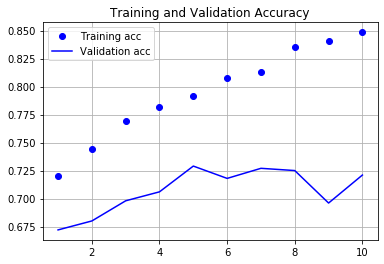

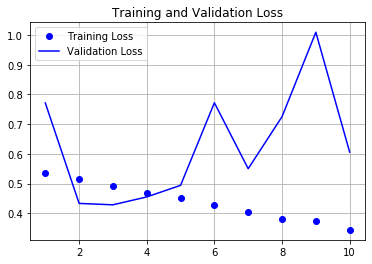

In [82]:
import matplotlib.pyplot as plt

acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.grid()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid()
plt.show()



The above plots are characteristic of overfitting.

#### 5.2.5 Data Augmentation

Data augmentation takes the approach of generating more training data from existing training samples, by augmenting the samples via a number of random transformations that yield believable-looking images. This helps expose the model to more aspects of the data and generalize better.

In [84]:
datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2, 
    height_shift_range=0.2, 
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
    )

- rotation_range is a value in degress (0-180), a range within which to randomly rotate pictures
- width_shift and height_shift are ranges (as a fraction of total width or height) within which to randomly translate pictures
- shear_range is for randomly zooming inside pictures
- horizontal_flip is for randomly flipping half the images horizontally 
- fill_mode is the strategy used for filling in newly created pixels, which can appear after a rotation or a width/height shift

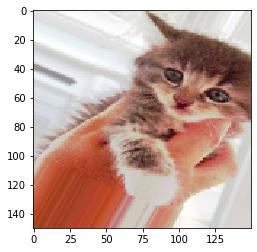

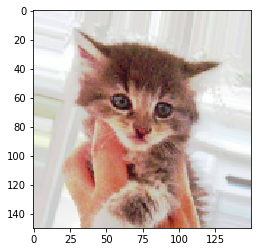

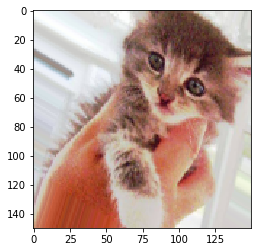

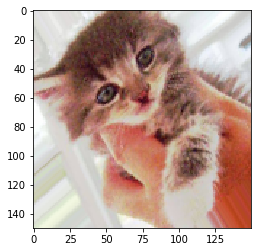

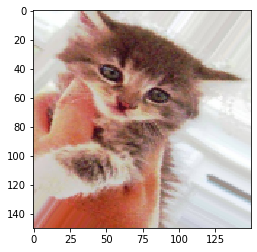

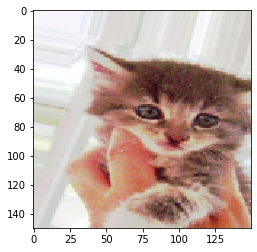

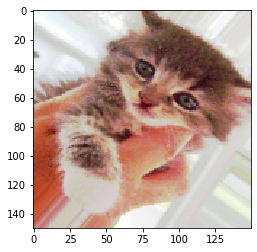

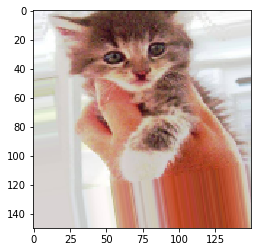

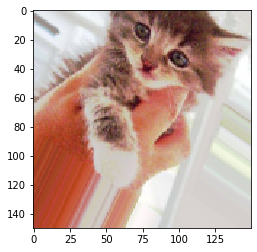

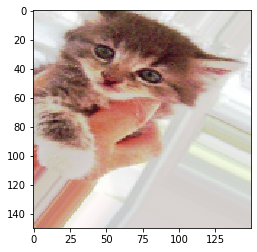

In [89]:
from keras.preprocessing import image

fnames = [os.path.join(train_cats_dir, fname) for fname in os.listdir(train_cats_dir)]

img_path = fnames[3]
img = image.load_img(img_path, target_size=(150, 150))
x = image.img_to_array(img)
x = x.reshape((1, ) + x.shape)

i = 0
for batch in datagen.flow(x, batch_size=1):
    plt.figure()
    imgplot = plt.imshow(image.array_to_img(batch[0]))
    i+=1
    if i == 10:
        break

plt.show()

If you train a network using this data augmentation configuration, the network will never see the same input twice, but the inputs are still heavily intercorrelated, because they come from a small number of original images. We'll add a dropout layer to further fight overfitting.

In [92]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [93]:
model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

In [96]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2, 
    shear_range=0.2, 
    zoom_range=0.2,
    horizontal_flip=True
)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary'
)

validation_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary'
)

history = model.fit_generator(
    train_generator,
    steps_per_epoch=100,
    epochs=20,
    validation_data=validation_generator,
    validation_steps=50
)

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.
Epoch 1/20
100/100 [==============================] - 107s 1s/step - loss: 0.6923 - acc: 0.5198 - val_loss: 0.6630 - val_acc: 0.5806
Epoch 2/20
100/100 [==============================] - 161s 2s/step - loss: 0.6705 - acc: 0.5774 - val_loss: 0.6357 - val_acc: 0.6179
Epoch 3/20
100/100 [==============================] - 157s 2s/step - loss: 0.6384 - acc: 0.6228 - val_loss: 0.6278 - val_acc: 0.6497
Epoch 4/20
100/100 [==============================] - 168s 2s/step - loss: 0.6158 - acc: 0.6515 - val_loss: 0.5134 - val_acc: 0.6946
Epoch 5/20
100/100 [==============================] - 165s 2s/step - loss: 0.6145 - acc: 0.6613 - val_loss: 0.6118 - val_acc: 0.6942
Epoch 6/20
100/100 [==============================] - 166s 2s/step - loss: 0.5936 - acc: 0.6723 - val_loss: 0.8076 - val_acc: 0.6469
Epoch 7/20
100/100 [==============================] - 165s 2s/step - loss: 0.5853 - acc: 0.6856 - val_loss: 0.5560 - v

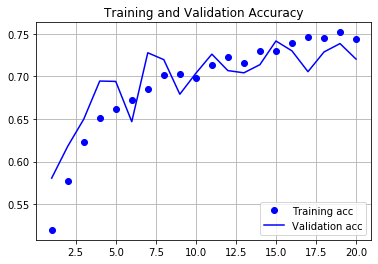

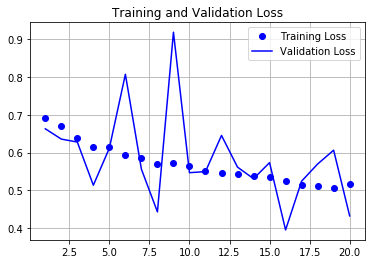

In [97]:
import matplotlib.pyplot as plt

acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.grid()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid()
plt.show()



### 5.3 Using a pretrained convnet

A pretrained network is a saved network that was previously trained on a large dataset, typically ona  large-scale image-classification task. If this original dataset is large enough and general enough, then the spatial hierarchy of features learned by the pretrained network can effectively act as a generic model of the visual world and hence its features can prove useful for many different computer vision problems.

There are two ways to use a pretrained network: feature extraction and fine-tuning. 

#### 5.3.1 Feature Extraction

Feature extraction consists of learning representations learned by a previous network to extract interesting features from new samples. These features are then run through a new classifier which is trained from scratch.

The first part of a classifier is called the convolutional base. Feature extraction takes the convolutional base of a previously trained network, running the new data through it. We don't use the densely connected classifier as representations learnt by the base are much more likely to be generic.

Note that the level of generality of the respresentations extracted by specific convolution layers depends on the depth of the layer in the model. If the new dataset differs a lot from the dataset on which the original model was trained, you may be better off using only the first few layers of the model to do feature extraction.

The VGG16 model, among others, comes prepackaged with Keras. You can import is from the keras.applications module. Here's the list of image-classification models in keras.applications:
- Xception
- Inception V3
- ResNet50
- VGG16
- VGG19
- MobileNet

Let's instantiate the VGG16 model.

In [117]:
from keras.applications import VGG16

conv_base = VGG16(weights='imagenet',
                  include_top=False,
                  input_shape=(50, 50, 3))

In [99]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0     

The final feature map has shape (4, 4, 512). That's the feature on top of which we'll stick a densely connected classifier. At this point there are two ways we could proceed:
- Running a convolutional base over your dataset, recording its output to a numpy array on disk and then using this input to a standalone densely connected classifier. This solution is fast and cheap to run, it only involves running the convbase once for every image. But we can't use data augmentation.
- Extending the model you have by adding Dense layers on top and running the whole thing end to end on input data. This will allow for data augmentation.

#### Fast Feature Extraction without data augmentation

We'll start by running instances of the previously introduced ImageDataGenerator to extract images as numpy arrays as well as their labels.

In [100]:
import os
import numpy as np
from keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(rescale=1./255)
batch_size=20

def extract_features(directory, sample_count):
    features = np.zeros(shape=(sample_count, 4, 4, 512))
    labels = np.zeros(shape=(sample_count))
    generator = datagen.flow_from_directory(
        directory, 
        target_size=(150, 150),
        batch_size=batch_size,
        class_mode='binary'
        )
    i = 0
    for inputs_batch, labels_batch in generator:
        features_batch = conv_base.predict(inputs_batch)
        features[i*batch_size:(i+1)*batch_size] = features_batch
        labels[i*batch_size:(i+1)*batch_size] = labels_batch
        i += 1
        if i * batch_size >= sample_count:
            break
    return features, labels

In [102]:
train_features, train_labels = extract_features(train_dir, 2000)
validation_features, validation_labels = extract_features(validation_dir, 1000)
test_features, test_labels = extract_features(test_dir, 1000)

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


In [106]:
train_features.shape

(2000, 4, 4, 512)

Before we feed the features to a densely connected classifier we must first flatten them. 

In [107]:
train_features = train_features.reshape(train_features.shape[0], -1)
validation_features = validation_features.reshape(validation_features.shape[0], -1)
test_features = test_features.reshape(test_features.shape[0], -1)

We can now define our densely connected classifier

In [108]:
train_features.shape

(2000, 8192)

In [109]:
from keras import models
from keras import layers 
from keras import optimizers

model = models.Sequential()
model.add(layers.Dense(256, activation='relu', input_dim = 8192))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(1, activation='sigmoid'))

model.compile(optimizer=optimizers.RMSprop(lr=2e-5),
              loss='binary_crossentropy',
              metrics=['acc'])

history = model.fit(train_features, train_labels,
                   epochs=30,
                   batch_size=20,
                   validation_data=(validation_features, validation_labels))

Train on 2000 samples, validate on 1000 samples
Epoch 1/30
2000/2000 [==============================] - 3s 2ms/step - loss: 0.6135 - acc: 0.6590 - val_loss: 0.4585 - val_acc: 0.8100
Epoch 2/30
2000/2000 [==============================] - 3s 1ms/step - loss: 0.4445 - acc: 0.8000 - val_loss: 0.3680 - val_acc: 0.8620
Epoch 3/30
2000/2000 [==============================] - 3s 1ms/step - loss: 0.3729 - acc: 0.8310 - val_loss: 0.3280 - val_acc: 0.8800
Epoch 4/30
2000/2000 [==============================] - 3s 1ms/step - loss: 0.3222 - acc: 0.8655 - val_loss: 0.3041 - val_acc: 0.8910
Epoch 5/30
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2964 - acc: 0.8810 - val_loss: 0.2912 - val_acc: 0.8850
Epoch 6/30
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2576 - acc: 0.8970 - val_loss: 0.2768 - val_acc: 0.8950
Epoch 7/30
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2555 - acc: 0.9020 - val_loss: 0.2735 - val_acc: 0.8880
Epoch 8/30
200

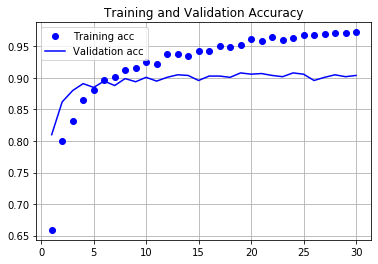

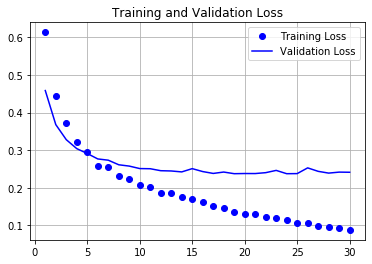

In [110]:
import matplotlib.pyplot as plt

acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.grid()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid()
plt.show()



We reach a much higher validation accuracy than we achieved in the previous section with the small model trained from scratch, but the plots also indicate overfitting very quickly. That's because the technique doesn't use data augmentation.

#### Feature Extraction with Data Augmentation

This is a much slower and more expensive technique, but allows for data augmentation. Because models behave just like layers, you can add a model (like conv_base) to a Sequential model just like you would add a layer.

In [128]:
from keras.applications import VGG16

conv_base = VGG16(weights='imagenet',
                  include_top=False,
                  input_shape=(100, 100, 3))

In [129]:
from keras import models
from keras import layers

model = models.Sequential()
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [130]:
model.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 3, 3, 512)         14714688  
_________________________________________________________________
flatten_8 (Flatten)          (None, 4608)              0         
_________________________________________________________________
dense_18 (Dense)             (None, 256)               1179904   
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 257       
Total params: 15,894,849
Trainable params: 15,894,849
Non-trainable params: 0
_________________________________________________________________


Before we compile and train the model, it's very important to add a convolutional base. _Freezing_ a layer or set of layers prevents their weights being updated during training.

In [131]:
conv_base.trainable = False

In order for the changes to take effect, you must first compile the model. If you every modify weight trainability after compilation, you should then recompile the model, or these changes will be ignored. 

In [154]:
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers

train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    batch_size=20,
    target_size=(150, 150),
    class_mode='binary'
)

validation_generator = test_datagen.flow_from_directory(
    validation_dir,
    target_size=(150, 150),
    batch_size=20,
    class_mode='binary'
)

# model.compile(loss='binary_crossentropy',
#               optimizer=optimizers.RMSprop(lr=2e-5),
#               metrics=['acc'])

# history = model.fit_generator(
#     train_generator,
#     steps_per_epoch=100,
#     epochs=30,
#     validation_data=validation_generator,
#     validation_steps=50
# )

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


#### 5.3.2 Fine-tuning

Another widely used technique for model reuse, complementary to feature extraction, is _fine-tuning_. Fine tuning consists of unfreezing a few of the top layers of a frozen model base used for feature extraction, and jointly training both the newly added part of the model and these top layers. This is called fine-tuning because it adjusts the more abstract representions of the mdoel being reused in order to make them more relevant for the problem at hand. 

Steps for fine-tuning a network:
1. Add your custom network on top of an already trained base network.
2. Freeze the base network
3. Train the part you added
4. Unfreeze some layers in the base network
5. Jointly train both these layers and the part you added.

In [155]:
from keras.applications import VGG16

conv_base = VGG16(weights='imagenet',
                  include_top=False,
                  input_shape=(150, 150, 3))

In [156]:
conv_base.trainable = True
set_trainable = False
for layer in conv_base.layers:
    if layer.name == 'block5_conv1':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

In [159]:
from keras import models
from keras import layers

model = models.Sequential()
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [161]:
model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-5),
              metrics=['acc'])

In [163]:
# history = model.fit_generator(
#     train_generator,
#     steps_per_epoch=100,
#     epochs=100,
#     validation_data=validation_generator,
#     validation_steps=50
# )

Using the above methodology we will get a test accuracy of 97%. In the original kaggle competetition, this would have been one of the top results.

#### 5.3.3 Wrapping up

Here's what you should take away from the exercises in the past two sections:
- Convnets are the best type of machine-learning models for computer-vision tasks. It's possible to train one from scratch even on a very small dataset, with decent results.
- On a small dataset, overfitting will be the main issue. Data augmentation is a powerful way to fight overfitting when you're working with image data.
- It's easy to reuse an existing convnet ona  new dataset via feature extraction. This is a valuable technique for working with small image datasets. 
- As a complement to feature extraction, you can use fine-tuning, which adapts to a new problem some of the representations previously learned by an existing model. This pushes performance a bit further.

### 5.4. Visualising what convnets learn

Often said that deep learning models are black boxes, not true for convnets. Representations learnt by convnets are highly emenable to visualization, as they are _represenations of visual concepts_. Since 2013, a wide array of techniques have been developed for visualising and interpreting these represenations. We'll cover the most accessible and usable ones:

- Visualising intermediate convnet outputs - Useful for understanding how successive convnet layers tranform their input.
- Visualising convnet filters - Useful for understanding precisely what pattern or concept each filter ina  convnet is receptive to.
- _Visualising heatmaps of class activation in an image_ - Useful for understanding which parts of an image were were identified as  belonging to a given class. 

#### 5.4.1. Visualising intermediate activations 

Visualising intermediate activations consists of displaying the feature maps that are output by various convolution and pooling layers in a network. This gives a view of how an input is decomposed into the different filters learnt by the network. This gives a view into how an input is decomposed into the different filters learned by the network. You want to visualise feature maps with three dimensions: width, height and depth. Each channel encodes relatively independent features, so the proper way to visualise the fesature maps is by independently plotting the contents of every channel as a 2D image.

In [1]:
from keras.models import load_model
model = load_model('cats_and_dogs_small_1.h5')
model.summary()

Using TensorFlow backend.


Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 34, 34, 64)        36928     
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 17, 17, 64)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 15, 15, 64)       

In [12]:
img_path = "C:/Users/tjs_1/Downloads/cats_and_dogs_small/test/cats/cat.1700.jpg"

In [13]:
from keras.preprocessing import image 
import numpy as np

img = image.load_img(img_path, target_size=(150, 150))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor /= 255

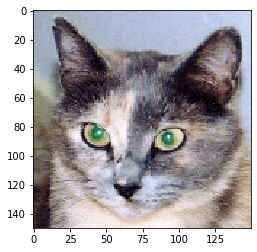

In [21]:
import matplotlib.pyplot as plt

plt.imshow(img_tensor[0])

In order to extract the feature maps you we want to look at, we'll create a keras model that takes batches of images of input and outputs the activations of all convolution and pooling layers. To do this, you'll use the keras class __Model__. A model is instantiated using two arguments, a set of inputs and a set of outputs. The resulting class is a Keras model, just the like _Sequential_ models we're familiar with. The Model class allows for multiple outputs. 

In [22]:
from keras import models

layer_outputs = [layer.output for layer in model.layers[:8]]
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)

When fed an input image, this model returns the values of the layer activations in the original model. In the general case, a model can have any number of inputs and outputs. This one has one input and eight outputs: one output per layer activation.

In [28]:
activations = activation_model.predict(img_tensor)

In [34]:
first_layer_activation = activations[0]

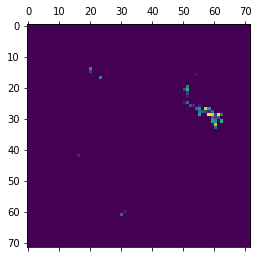

In [46]:
plt.matshow(activations[2][0, :, :, 7], cmap='viridis')

Let's plot a complete visualisation of all the activations in the network. You'll extract and plot every channel in each of the eight activation maps and you'll stack the results in one big image tensor.

C:\Users\tjs_1\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


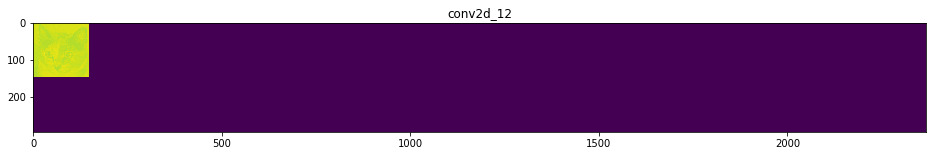

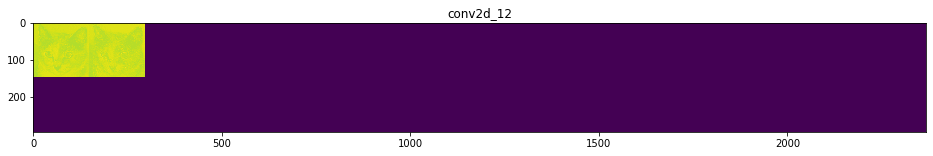

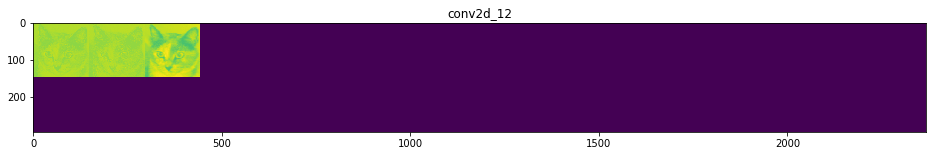

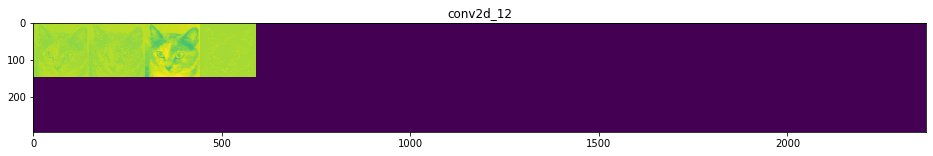

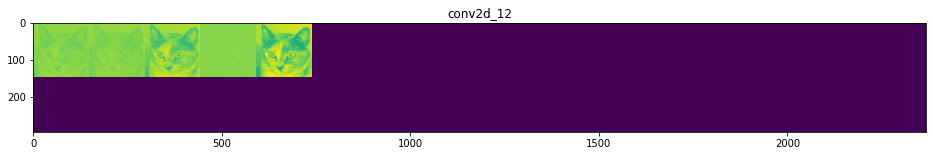

...

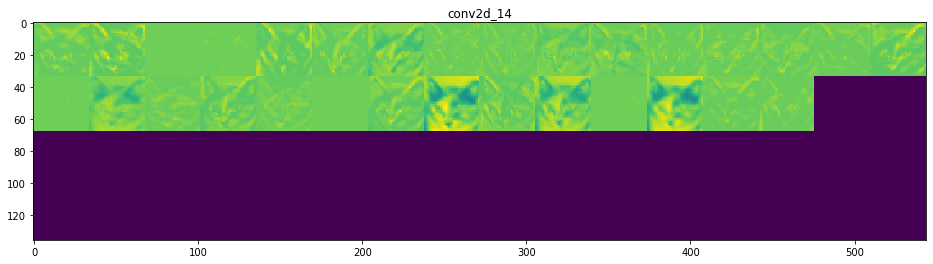

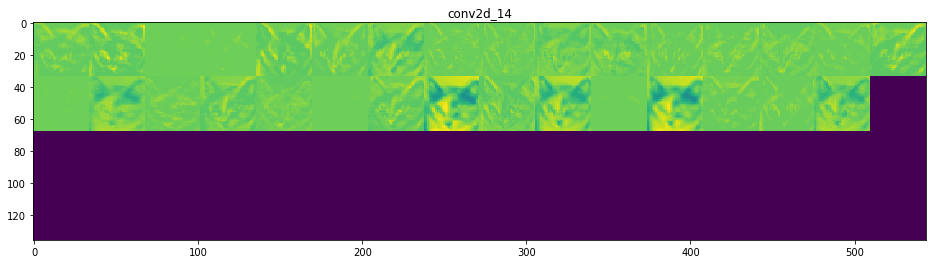

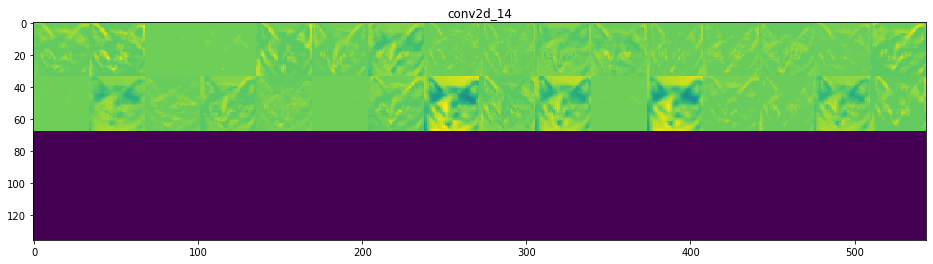

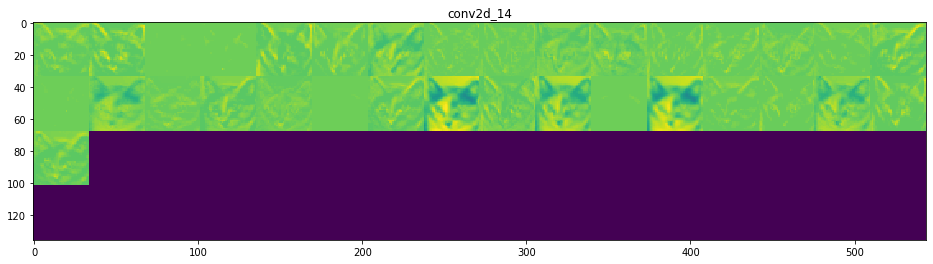

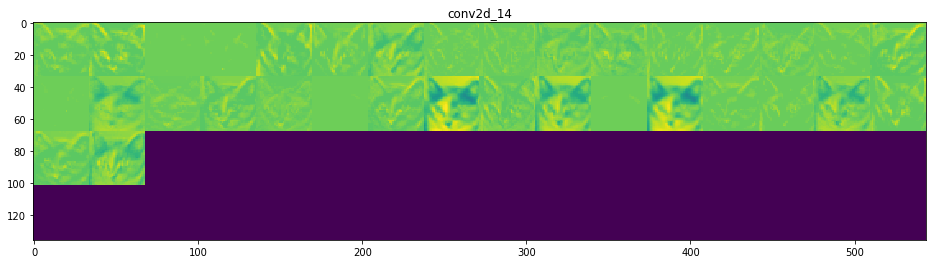

Error in callback <function flush_figures at 0x000001B93DF5A558> (for post_execute):


KeyboardInterrupt: 

In [47]:
layer_names = []
for layer in model.layers[:8]:
    layer_names.append(layer.name)
    
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size*n_cols, images_per_row*size))
    
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, col*images_per_row + row]
            channel_image -= channel_image.mean()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image
            
            scale = 1. / size
            plt.figure(figsize=(scale * display_grid.shape[1],
                                scale * display_grid.shape[0]))
            plt.title(layer_name)
            plt.grid(False)
            plt.imshow(display_grid, aspect='auto', cmap='viridis')

There are a few things to note here:
 
- The first layer acts as a collection of various edge detectors. At that stage, the activations retain almost all of the information present in the initial picture.
- As you go higher, the activations become increasingly abstract less visually interpretable. They begin to encode higher-level concepts such as cat ear and cat eye. 
- The sparsity of the activations increases with the depth of the layer: in the first layer, all filters are activated byt he input image, but in the following layers, more and more filters are blank. This means the pattern encoded by the filter isn't present in the image.

We have just evidenced an important characteristic of the representations learned by deep neural networks: the features extracted by a layer become increasingly abstract with the depth of the layer. The activatoins of higher layers carrt less and less information about the specific input being seen, and more and more information about the target. A deep neural network effectively acts as an _information distillation pipeline_, with raw information going in and being repeatedly transformed so that irrelevant information is filtered out.

#### 5.4.2 Visualizing convnet filters

Another easy way to inspect the filters learned by convnets is to display the visual pattern that each filter is meant to respond to. This can be done with _gradient ascent_ in input space: applying gradient descent to the value of the input image of a convnet so as to maximise the response of a specific filter, starting from a blank input image. The resulting input image will be one that the chosen filter is maximally responsive to. 

We build a loss function that maximises the value of a given filter in a given convolutional layer, and you'll use stochastic gradient descent to adjust the values of the input image so as to maximise this activation value. 

In [52]:
from keras.applications import VGG16
from keras import backend as K

model = VGG16(weights='imagenet',
              include_top=False)

layer_name = 'block3_conv1'
filter_index = 0

layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index])

To implement gradient descent, you'll need the gradient of this loss with respect to the model's input. To do this, you'll use the gradients function packaged with the backend module of keras.

In [53]:
grads = K.gradients(loss, model.input)[0]

In [57]:
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

Now you need a way to compute the value of the loss tensor and the gradient tensor, given an input image. You can define a keras backend function to do this: __iterate__ is a function that takes a numpy tensor and returns a list of two numpy tensors: the loss value and the gradient value.

In [58]:
iterate = K.function([model.input], [loss, grads])

In [61]:
import numpy as np
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

At this point, we can define a python loop to do stochastic gradient descent.

In [62]:
input_img_data = np.random.random((1, 150, 150, 3)) * 20 + 128

step = 1
for i in range(60):
    loss_value, grads_value = iterate([input_img_data])
    input_img_data = grads_value * step

In [73]:
def deprocess_image(x):
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    
    x += 0.5
    x = np.clip(x, 0, 1)
    
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    
    return x

Now we have all the pieces. Let's put them together into a python function that takes as input a layer name and a filter index and returns a valid image tensor representing the pattern that maximises the activation of the specified filter.

In [76]:
def generate_pattern(layer_name, filter_index, size=150):
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])
    grads = K.gradients(loss, model.input)[0]
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    iterate = K.function([model.input], [loss, grads])
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128
    step = 1
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
    img = input_img_data[0]
    return deprocess_image(img)

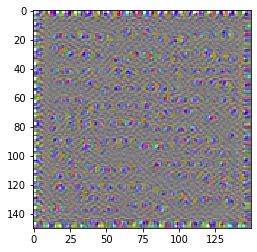

In [79]:
plt.imshow(generate_pattern('block3_conv1', 2))

These filter visualisations tell you a lot about how convnet layers see the world: each layer in a convnet learns a collection of filters such that their inputs can be expressed as a combination of the filters. This is similar to how the Fourier tranform decomposes signals onto a bank of cosine functions. The filters in these convnet filter banks get increasingly complex and regined as you go higher in the model.

- The filters from the first layer in the model encode simple directional edges and colors
- The filters from block2_conv1 encode simple textures from combinations of edges and colours
- The filters in higher layers begin to resemble textures found in natural images: feathers, eyes, leaves etc.

#### 5.4.3 Visualising heatmaps of class activation

We'll now introduce one more visualisation technique: one that is useful for understanding which parts of a given image led a convnet to its final classification decision. This general catefory of techniques is called _class activation map_ (CAM) visualisation and it consists of producing heatmaps of class activation over input images. A class activation map is a 2D grid of scores associated with a specific output class. 

The implementation is very simple, it consists of taking the output feature map of a convolutional layer, given an input image, and weighing every channel in that feature map by the gradient of the class with respect to the channel. Intuitively, one way to understand this trick is that you're weighting a spatial map of "how intensely the input image activates different channels" by "how important each channel is with regard to the class," resulting in a spatial map of "how intensely the input image activates the class". 

In [80]:
from keras.applications.vgg16 import VGG16
model = VGG16(weights='imagenet')
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input, decode_predictions
import numpy as np

img_path = "Downloads/creative_commons_elephants.jpg"

553467904/553467096 [==============================] - 2293s 4us/step


### Chapter Summary
- Convnets are the best tool for attacking visual classification problems.
- Convnets work by learning a hierarchy of modular patterns and concepts to represent the visual world.
- The representations they learn are easy to inspect - convnets are the opposite of black boxes
- We're now capable of training our own convnet from scratch to solve an image classificaiton problem.
- We understand how to use data augmentation to fight overfitting.
- You know how to use a pretrained convnet to do feature extraction and fine-tuning
- You can generate visualizations of the filters learned by your convnets, as well as heatmaps of activity.